In [37]:
import cv2
import numpy as np
import os
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from sklearn.decomposition import PCA
from sklearn.metrics.pairwise import cosine_similarity
import time
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.models import resnet50

In [ ]:
def load_images_from_directory(directory, limit=None):
    images = []
    for folder in os.listdir(directory):
        folder_path = os.path.join(directory, folder)
        if os.path.isdir(folder_path):
            for filename in os.listdir(folder_path):
                if filename.endswith(('.jpg', '.jpeg', '.png')):
                    img_path = os.path.join(folder_path, filename)
                    images.append(img_path)
                    if limit and len(images) >= limit:
                        break
    return images

data_path1 = '/home/samsepi0l/TErm 7/CV/Mini_pro/dtd-r1.0.1/dtd/images' 
data_path2_train = '/home/samsepi0l/TErm 7/CV/Mini_pro/archive/dataset/training_set'  #
data_path2_test = '/home/samsepi0l/TErm 7/CV/Mini_pro/archive/dataset/test_set'

train_images1 = load_images_from_directory(data_path1, limit=470)
test_images1 = load_images_from_directory(data_path1, limit=30)

train_images2 = load_images_from_directory(data_path2_train)
test_images2 = load_images_from_directory(data_path2_test)

print(f'Training data size (Dataset 1): {len(train_images1)}')
print(f'Testing data size (Dataset 1): {len(test_images1)}')
print(f'Training data size (Dataset 2): {len(train_images2)}')
print(f'Testing data size (Dataset 2): {len(test_images2)}')

Training data size (Dataset 1): 513
Testing data size (Dataset 1): 76
Training data size (Dataset 2): 900
Testing data size (Dataset 2): 100


In [39]:
def extract_color_histogram(image_path):
    image = cv2.imread(image_path)
    chans = cv2.split(image)
    colors = ('b', 'g', 'r')
    features = []

    for (chan, color) in zip(chans, colors):
        hist = cv2.calcHist([chan], [0], None, [256], [0, 256])
        hist = cv2.normalize(hist, hist).flatten()
        features.extend(hist)

    return np.array(features)

train_color_hist1 = [extract_color_histogram(img) for img in train_images1]
test_color_hist1 = [extract_color_histogram(img) for img in test_images1]
train_color_hist2 = [extract_color_histogram(img) for img in train_images2]
test_color_hist2 = [extract_color_histogram(img) for img in test_images2]

In [40]:
def extract_lbp(image_path, num_points=24, radius=8):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    lbp = local_binary_pattern(image, num_points, radius, method="uniform")
    (hist, _) = np.histogram(lbp.ravel(), bins=np.arange(0, num_points + 3), range=(0, num_points + 2))
    hist = hist.astype("float")
    hist /= (hist.sum() + 1e-6)
    return hist

train_lbp1 = [extract_lbp(img) for img in train_images1]
test_lbp1 = [extract_lbp(img) for img in test_images1]
train_lbp2 = [extract_lbp(img) for img in train_images2]
test_lbp2 = [extract_lbp(img) for img in test_images2]

In [41]:
def extract_hog(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    resized_img = cv2.resize(image, (128, 128))
    hog = cv2.HOGDescriptor()
    h = hog.compute(resized_img)
    return h.flatten()

train_hog1 = [extract_hog(img) for img in train_images1]
test_hog1 = [extract_hog(img) for img in test_images1]
train_hog2 = [extract_hog(img) for img in train_images2]
test_hog2 = [extract_hog(img) for img in test_images2]

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

resnet = resnet50(pretrained=True).to(device)
resnet.fc = nn.Identity()  
resnet.eval()

preprocess = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

def extract_resnet_features(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    input_tensor = preprocess(image).unsqueeze(0).to(device)
    with torch.no_grad():
        output = resnet(input_tensor)
    return output.cpu().flatten().numpy()

train_resnet1 = [extract_resnet_features(img) for img in train_images1]
test_resnet1 = [extract_resnet_features(img) for img in test_images1]
train_resnet2 = [extract_resnet_features(img) for img in train_images2]
test_resnet2 = [extract_resnet_features(img) for img in test_images2]

In [43]:
def combine_features(*features):
    return np.concatenate(features, axis=0)

train_combined_features1 = [combine_features(ch, lbp, hog, resnet) for ch, lbp, hog, resnet in zip(train_color_hist1, train_lbp1, train_hog1, train_resnet1)]
test_combined_features1 = [combine_features(ch, lbp, hog, resnet) for ch, lbp, hog, resnet in zip(test_color_hist1, test_lbp1, test_hog1, test_resnet1)]
train_combined_features2 = [combine_features(ch, lbp, hog, resnet) for ch, lbp, hog, resnet in zip(train_color_hist2, train_lbp2, train_hog2, train_resnet2)]
test_combined_features2 = [combine_features(ch, lbp, hog, resnet) for ch, lbp, hog, resnet in zip(test_color_hist2, test_lbp2, test_hog2, test_resnet2)]

In [ ]:
train_combined_features1 = np.array(train_combined_features1)
test_combined_features1 = np.array(test_combined_features1)
train_combined_features2 = np.array(train_combined_features2)
test_combined_features2 = np.array(test_combined_features2)

pca = PCA(n_components=100) 
train_combined_features_pca1 = pca.fit_transform(train_combined_features1)
test_combined_features_pca1 = pca.transform(test_combined_features1)
train_combined_features_pca2 = pca.fit_transform(train_combined_features2)
test_combined_features_pca2 = pca.transform(test_combined_features2)

print(f'Original shape (Dataset 1): {train_combined_features1.shape}')
print(f'Reduced shape (Dataset 1): {train_combined_features_pca1.shape}')
print(f'Original shape (Dataset 2): {train_combined_features2.shape}')
print(f'Reduced shape (Dataset 2): {train_combined_features_pca2.shape}')

Original shape (Dataset 1): (513, 36862)
Reduced shape (Dataset 1): (513, 100)
Original shape (Dataset 2): (900, 36862)
Reduced shape (Dataset 2): (900, 100)


In [47]:
def euclidean_distance(query_image, compared_images):
    distances = [np.linalg.norm(query_image - img) for img in compared_images]
    return np.argmin(distances)

def euclidean_distance_top10(query_image, compared_images):
    distances = [np.linalg.norm(query_image - img) for img in compared_images]
    return np.argsort(distances)[:10]

In [48]:
def cosine_similarity_metric(query_image, compared_images):
    similarities = [cosine_similarity([query_image], [img])[0][0] for img in compared_images]
    return np.argmax(similarities)

In [49]:
def plot_images(query_img_path, similar_img_path):
    query_img = cv2.imread(query_img_path)
    similar_img = cv2.imread(similar_img_path)
    plt.subplot(121)
    plt.title("Query Image")
    plt.imshow(cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB))
    plt.subplot(122)
    plt.title("Similar Image")
    plt.imshow(cv2.cvtColor(similar_img, cv2.COLOR_BGR2RGB))
    plt.show()

def plot_top10_matches(query_img_path, top10_indices, compared_images):
    query_img = cv2.imread(query_img_path)
    plt.subplot(4, 3, 1)
    plt.title("Query Image")
    plt.imshow(cv2.cvtColor(query_img, cv2.COLOR_BGR2RGB))
    for i, idx in enumerate(top10_indices, 2):
        plt.subplot(4, 3, i)
        img = cv2.imread(compared_images[idx])
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
    plt.show()

Evaluating performance on Dataset 1


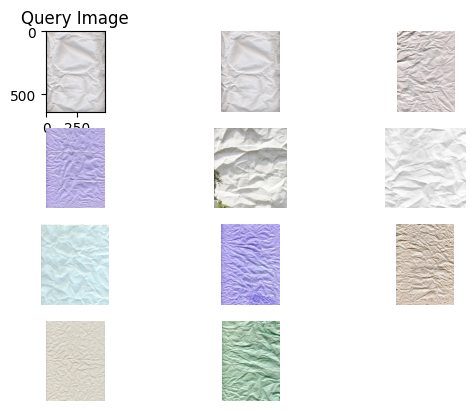

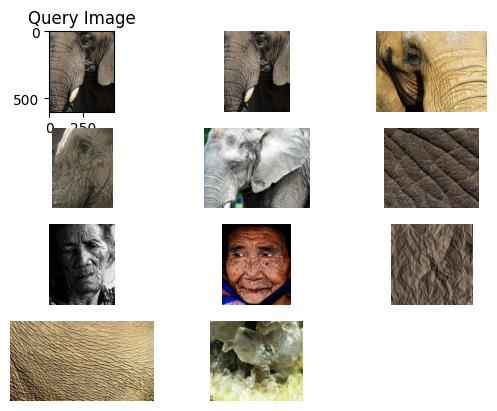

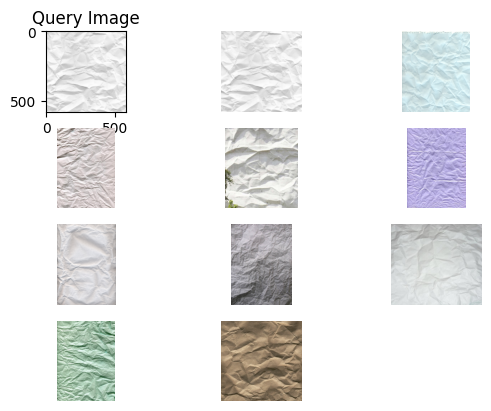

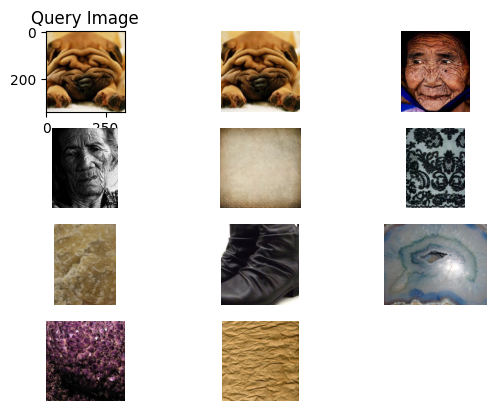

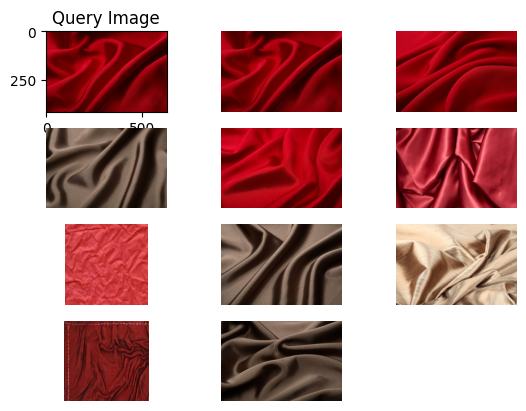

...

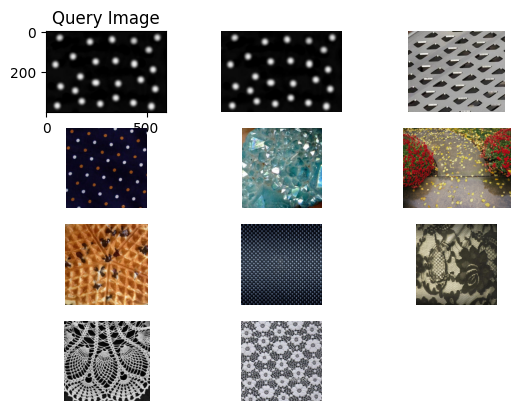

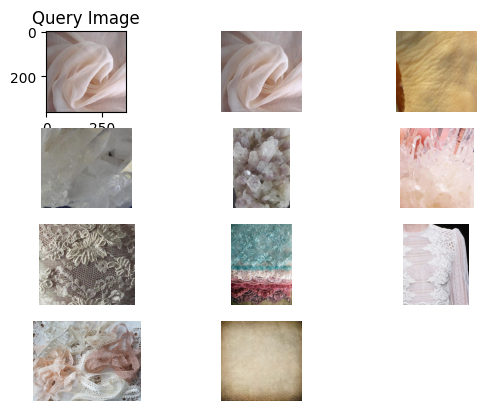

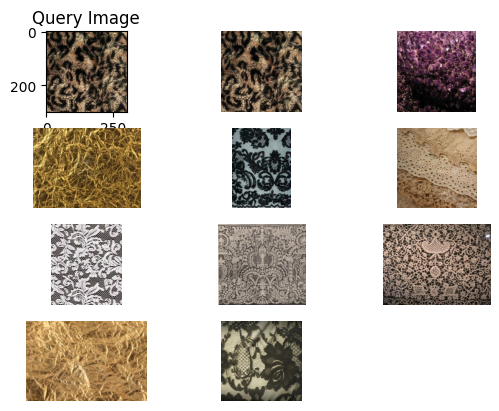

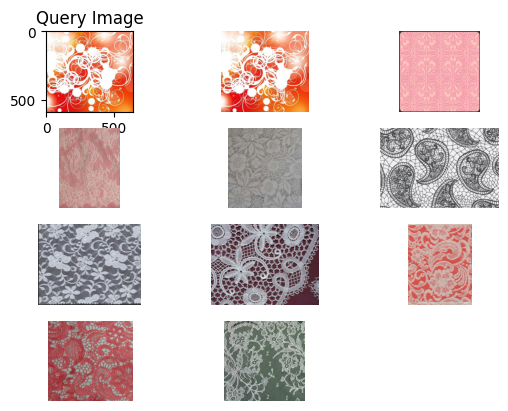

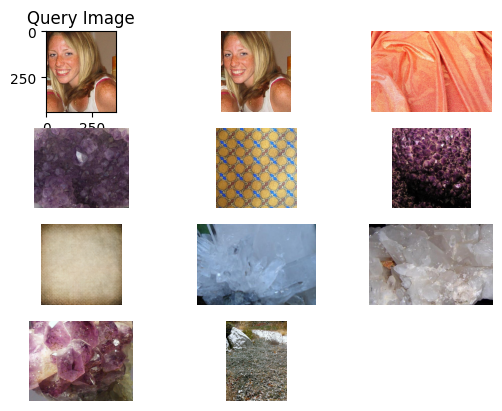

Average retrieval time: 0.0013 seconds
Precision at 1: 0.0000
Precision at 10: 0.1000


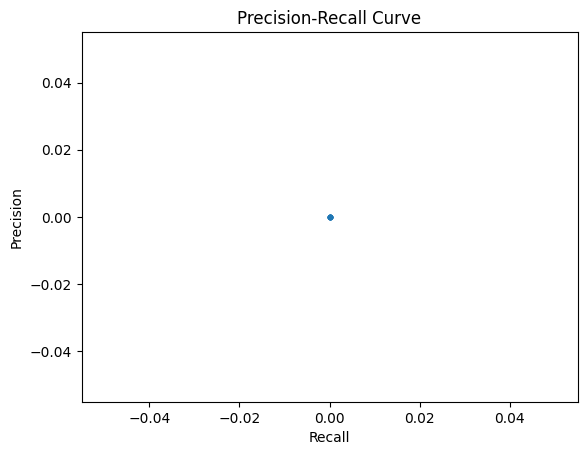

Evaluating performance on Dataset 2


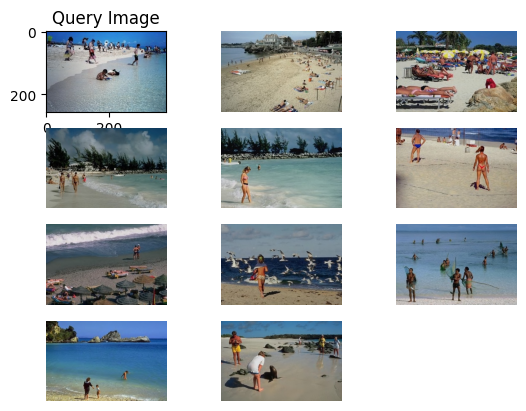

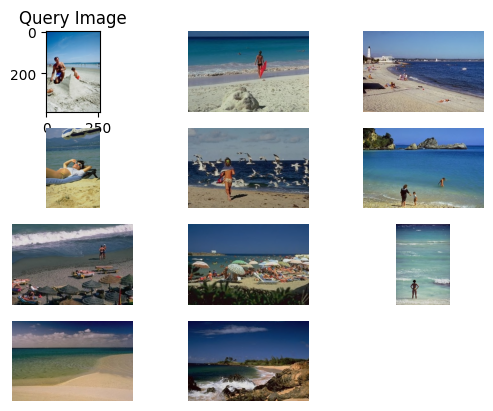

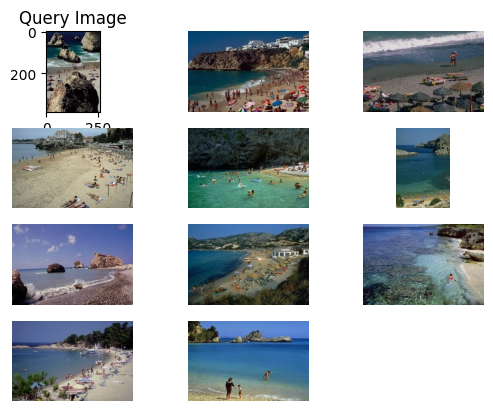

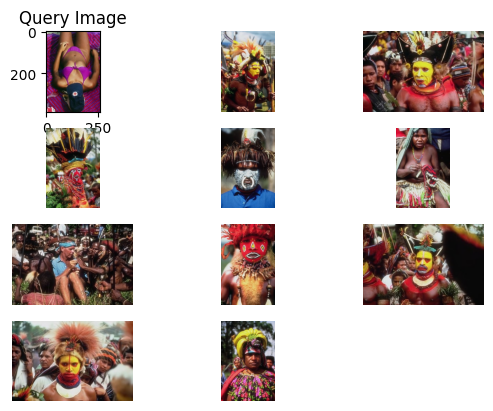

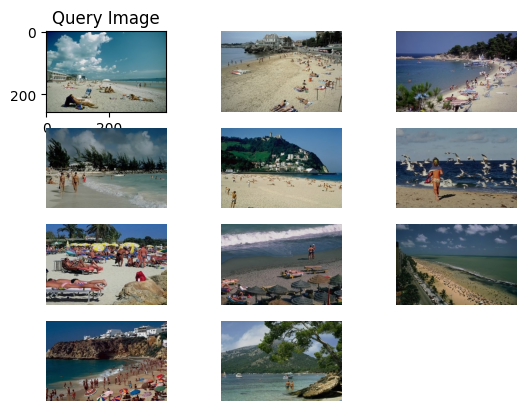

...

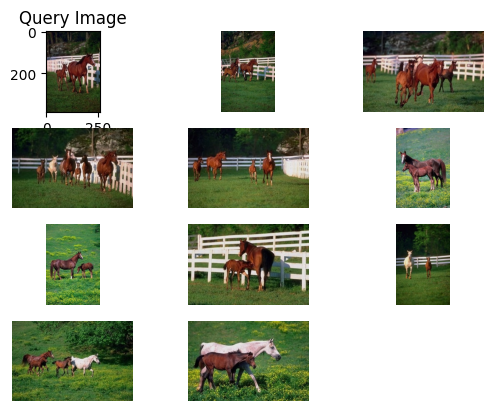

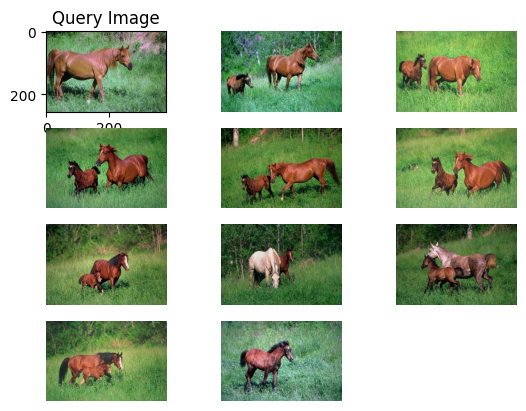

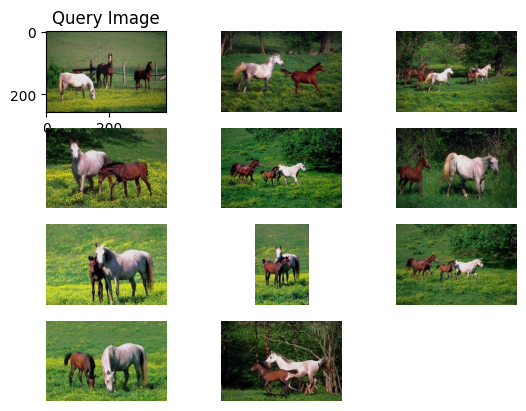

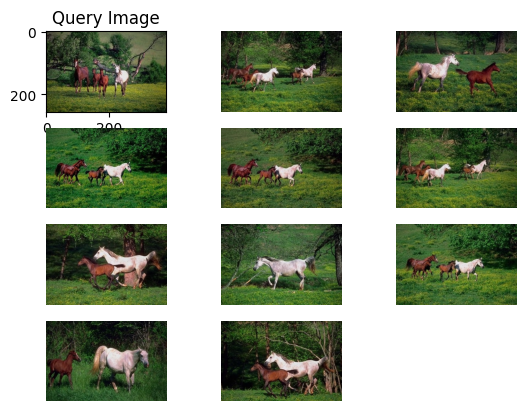

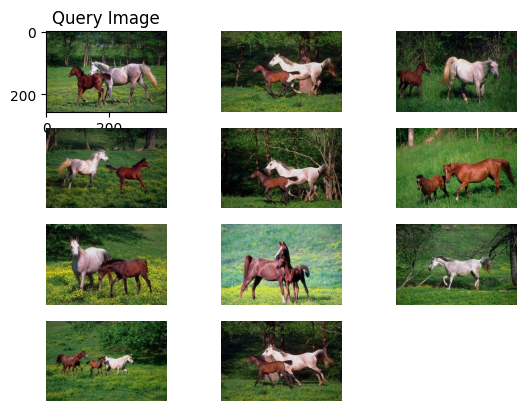

Average retrieval time: 0.0022 seconds
Precision at 1: 0.0000
Precision at 10: 0.0000


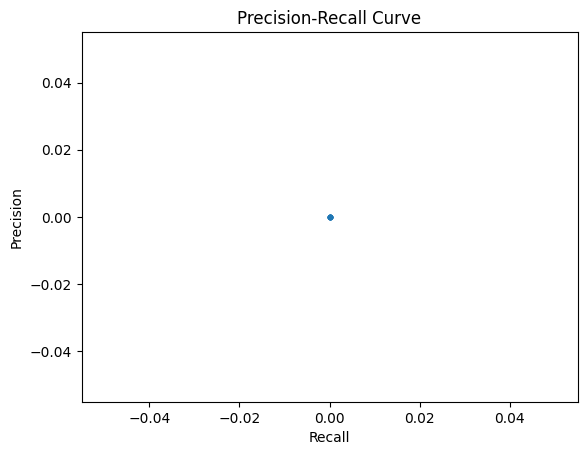

In [ ]:
def evaluate_performance(test_features, train_features, test_images, train_images):
    average_retrieval_time = 0
    top10_list = []
    for i, test_img in enumerate(test_features):
        start_time = time.time()
        top10 = euclidean_distance_top10(test_img, train_features)
        top10_list.append(top10)
        end_time = time.time()
        plot_top10_matches(test_images[i], top10, train_images)
        retrieval_time = end_time - start_time
        average_retrieval_time += retrieval_time

    print("Average retrieval time: {:.4f} seconds".format(average_retrieval_time / len(test_features)))

    ground_truth = np.array([10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
    precision_at_1 = np.sum([1 if ind[0] == gt else 0 for ind, gt in zip(top10_list, ground_truth)]) / len(ground_truth)
    precision_at_10 = np.sum([1 if gt in ind[:10] else 0 for ind, gt in zip(top10_list, ground_truth)]) / len(ground_truth)
    print(f'Precision at 1: {precision_at_1:.4f}')
    print(f'Precision at 10: {precision_at_10:.4f}')

    precision = []
    recall = []
    for k in range(1, 11):
        true_positives = 0
        retrieved = 0
        for ind, gt in zip(top10_list, ground_truth):
            retrieved += 1 if gt in ind[:k] else 0
            true_positives += 1 if gt == ind[0] else 0
        precision.append(true_positives / retrieved if retrieved > 0 else 0)
        recall.append(true_positives / len(ground_truth))

    plt.plot(recall, precision, marker='.')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.show()

print("Evaluating performance on Dataset 1")
evaluate_performance(test_combined_features_pca1, train_combined_features_pca1, test_images1, train_images1)

print("Evaluating performance on Dataset 2")
evaluate_performance(test_combined_features_pca2, train_combined_features_pca2, test_images2, train_images2)